# Attribution of universal noise pattern

Check which parts of the universal noise pattern are important

In [1]:
%load_ext autoreload
%autoreload 2
# imports
import datetime
import logging
import os
import pathlib
import sys

sys.path.insert(0, os.path.abspath('..'))
sys.path.insert(0, os.path.abspath('../..'))

import cv2
import numpy as np
import tensorflow as tf
from matplotlib import pyplot as plt

from deepexplain.tf.v1_x import DeepExplain
from plot_utils import plot, plt
from tf_pose import common
from tf_pose.common import CocoPart
from tf_pose.estimator import TfPoseEstimator
from tf_pose.networks import get_graph_path
from utils import print_image_Stats, load_batch


os.environ["TF_CPP_MIN_LOG_LEVEL"] = "3"
logging.getLogger("tensorflow").setLevel(logging.CRITICAL)
logging.getLogger('TfPoseEstimatorRun').setLevel(logging.ERROR)
logging.getLogger('DeepExplain').setLevel(logging.ERROR)
logging.getLogger('TfPoseEstimator').setLevel(logging.ERROR)

Using tf version = 1.15.0
The TensorFlow contrib module will not be included in TensorFlow 2.0.
For more information, please see:
  * https://github.com/tensorflow/community/blob/master/rfcs/20180907-contrib-sunset.md
  * https://github.com/tensorflow/addons
  * https://github.com/tensorflow/io (for I/O related ops)
If you depend on functionality not listed there, please file an issue.




In [2]:
# params 432, 368
w, h = 432, 368
image_path_target = '../data/images/dri_target_far_2.jpg'
train_dir = '../data/cocoval2017Humans/train'
test_dir = '../data/cocoval2017Humans/test'
model = 'cmu'
log_dir = '../logs/'


resize_out_ratio = 2.0
image_target = common.read_imgfile(image_path_target, w, h)
summary_writer = tf.summary.FileWriter(
    log_dir + "uniadv/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
training_paths = pathlib.Path(train_dir).glob('*.jpg')
training_paths = sorted([x for x in training_paths])
test_paths = pathlib.Path(test_dir).glob('*.jpg')
test_paths = sorted([x for x in test_paths])

In [3]:
estimator = TfPoseEstimator(get_graph_path(
    model), target_size=(w, h), trt_bool=False)
upsample_size = [int(estimator.target_size[1] / 8 * resize_out_ratio),
                 int(estimator.target_size[0] / 8 * resize_out_ratio)]
# get all outputs as np matrix
target_np, target_np_heat, target_np_paf, target_np_peaks = estimator.persistent_sess.run(
    [estimator.tensor_output, estimator.tensor_heatMat_up,
        estimator.tensor_pafMat_up, estimator.tensor_peaks],
    feed_dict={
        estimator.tensor_image: [image_target],
        estimator.upsample_size: upsample_size
    }
)

In [4]:
training_stats = {}
training_stats['universal_noise'] = np.load(
    '../snapshots/op_universal_noise_20200205-145237.npy')

Min: 0.0
Max: 255.0
Avg: 22.934496779482156


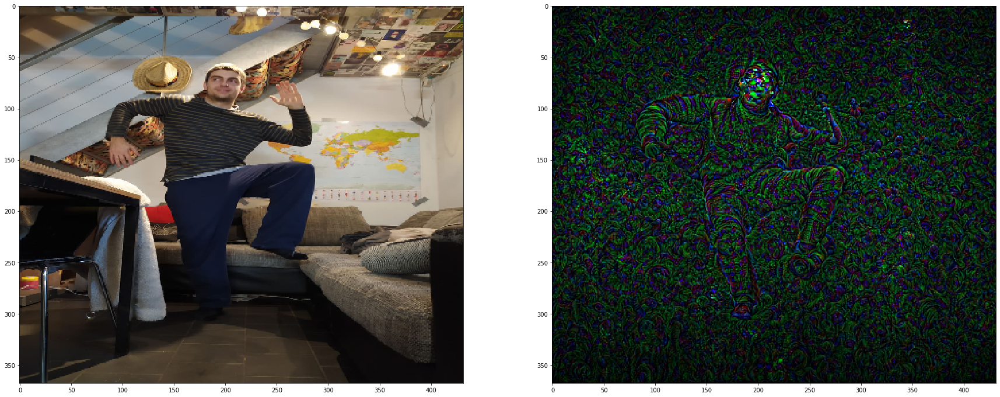

In [5]:
print_image_Stats(training_stats['universal_noise'])
fig = plt.figure(figsize=(30, 30))
ax = fig.add_subplot(1, 2, 1)
ax.imshow(cv2.cvtColor(image_target, cv2.COLOR_BGR2RGB))
ax = fig.add_subplot(1, 2, 2)
ax.imshow(np.clip(training_stats['universal_noise'], 0, 255) / 255)

In [30]:
BATCH_SIZE = 16
batch, batch_index = load_batch(test_paths, 0, BATCH_SIZE)
# set the test
universal_noise_batch = np.expand_dims(training_stats['universal_noise'], 0)
universal_noise_batch = np.repeat(universal_noise_batch, BATCH_SIZE, 0)
test_batch = np.clip(batch + universal_noise_batch, 0, 255)

ATTRIBUTION_PART = CocoPart.RWrist.value

with DeepExplain(session=estimator.persistent_sess, graph=estimator.graph) as de:
    input_tensor = estimator.tensor_image
    output_tensor = estimator.tensor_heatMat[:, :, :, ATTRIBUTION_PART]
    # input
    # tf.expand_dims(test_image, 0).eval(session=estimator.persistent_sess)
    xs = test_batch

    Y_shape = [None] + [1, 46, 54]  # size of heatmaps with resize
    ys = np.ones([BATCH_SIZE, ] + Y_shape[1:])
    #ys = np.expand_dims(np.expand_dims(mask, axis=0), axis=0)
    # print(Y_shape)
    # baseline = np.zeros(list(xs.shape)[1:]) # baseline to compare against

    attributions = {
        'Saliency maps':        de.explain('saliency', T=output_tensor, X=input_tensor, xs=batch, ys=ys, Y_shape=Y_shape),
        #'Gradient * Input':     de.explain('grad*input', T=output_tensor, X=input_tensor, xs=batch, ys=ys, Y_shape=Y_shape),
        'Saliency maps with noise':        de.explain('saliency', T=output_tensor, X=input_tensor, xs=xs, ys=ys, Y_shape=Y_shape),
        #'Gradient * Input with noise':     de.explain('grad*input', T=output_tensor, X=input_tensor, xs=xs, ys=ys, Y_shape=Y_shape),
    }

In [31]:
## compute heat maps
[heatmap_without_noise] = estimator.persistent_sess.run(
    [estimator.tensor_heatMat_up],
    feed_dict={
        estimator.tensor_image: batch,
        estimator.upsample_size: upsample_size
    }
)

[heatmap_with_noise] = estimator.persistent_sess.run(
    [estimator.tensor_heatMat_up],
    feed_dict={
        estimator.tensor_image: test_batch,
        estimator.upsample_size: upsample_size
    }
)

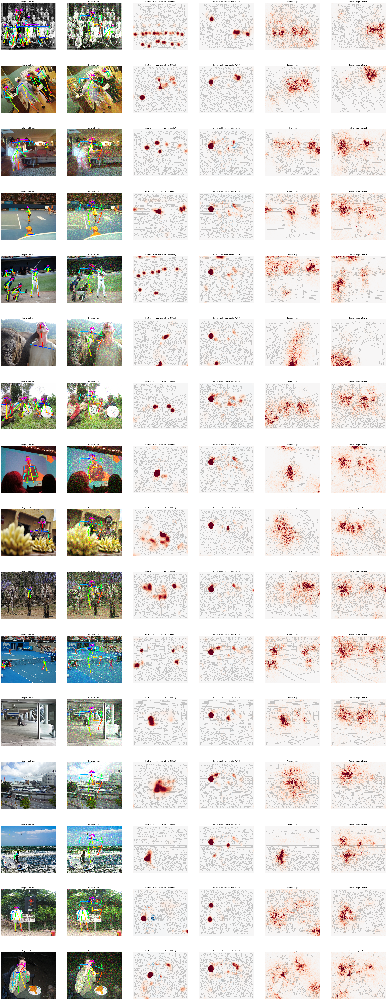

In [32]:
# Plot attributions
%matplotlib inline

# how many plots additionally to the attributions
EXTRA_PLOTS = 4

n_cols = int(len(attributions)) + EXTRA_PLOTS
n_rows = len(xs)
fig_scale = 3
fig, axes = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=(
    3*n_cols*fig_scale, 3*n_rows*fig_scale))

for i, xi in enumerate(batch):
    test_image = np.clip(xi + training_stats['universal_noise'], 0, 255)
    detections = estimator.inference(xi, resize_to_default=True, upsample_size=resize_out_ratio)
    detections_uni = estimator.inference(
        test_image, resize_to_default=True, upsample_size=resize_out_ratio)
    
    detections_result = TfPoseEstimator.draw_humans(
        xi, detections, imgcopy=True)
    detections_uni = TfPoseEstimator.draw_humans(
        test_image, detections_uni, imgcopy=True)

    
    ax = axes.flatten()[i*n_cols]
    ax.imshow(cv2.cvtColor(detections_result, cv2.COLOR_BGR2RGB))
    ax.set_title(
        f'Original with pose')
    ax.axis('off')
    
    ax = axes.flatten()[i*n_cols + 1]
    ax.imshow(cv2.cvtColor(detections_uni.astype(
        np.float32) / 255.0, cv2.COLOR_BGR2RGB))
    ax.set_title(
        f'Noise with pose')
    ax.axis('off')
    
    ax = axes.flatten()[i*n_cols + 2]
    plot(heatmap_without_noise[i,:,:, ATTRIBUTION_PART], xi=xi, axis=ax, 
             dilation=.5, percentile=99, alpha=.2).set_title(
    f'Heatmap without noise (attr for {CocoPart(ATTRIBUTION_PART).name})')
    
    ax = axes.flatten()[i*n_cols + 3]
    plot(heatmap_with_noise[i,:,:, ATTRIBUTION_PART], xi=xi, axis=ax,
             dilation=.5, percentile=99, alpha=.2).set_title(
    f'Heatmap with noise (attr for {CocoPart(ATTRIBUTION_PART).name})')
    
    xi = (xi - np.min(xi)).astype(np.float64)
    xi /= np.max(xi)
    for j, a in enumerate(attributions):
        axj = axes.flatten()[i*n_cols + j + EXTRA_PLOTS]
        plot(attributions[a][i], xi=xi, axis=axj,
             dilation=.5, percentile=99, alpha=.2).set_title(a)